<a href="https://colab.research.google.com/github/james-mccarron/GTA_Rental_Prices/blob/main/GTA_Rent_Pricing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# All imports
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import sys
import geopandas as gpd
import json
import time
import csv
import traceback
import requests
import openpyxl
from urllib import request
import urllib.request
import concurrent.futures
from bokeh.io import output_notebook, output_file, show
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bs4 import BeautifulSoup as bs
from selenium import webdriver
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.chrome.service import Service

##Obtaining Housing Data

In [ ]:
total_pages = 1000
links_df = pd.DataFrame(columns=['link'])

for page in range(1, (total_pages + 1)):
    url = 'https://www.zoocasa.com/toronto-on-real-estate/for-rent/leased?page=' + str(page)
    response = requests.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    address_elements = soup.find_all('p', class_='style_street-address__TsB7y')
    links = [element.find('a')['href'] for element in address_elements]

    # Append links to the DataFrame
    for link in links:
        links_df = links_df.append({'link': link}, ignore_index=True)

# Save the DataFrame to a CSV file
links_df.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/links.csv', index=False)

print("Links have been successfully saved to links.csv.")


In [ ]:
# Prepare a table for data population

links = pd.read_csv('/Users/james/Desktop/Projects/Rent_Prediction/links.csv')
data.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/output_data.csv', index=False)
data = pd.DataFrame(columns=['full_address','type','price','bedrooms','bathrooms','sqft','parking','mls','full_link', 'lat', 'long', 'city_district'])

In [ ]:
start_time = time.time()
skipped = []
house_length = links.shape[0]
headers = {
    'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.114 Safari/537.3'
        }
options = Options()
options.add_argument("--headless")
options.add_argument("--no-sandbox")
service = Service(executable_path="/usr/bin/chromedriver")
driver = webdriver.Chrome(service=service, options=options)
for no in range(house_length):
    try:
        url = 'https://www.zoocasa.com/' + str(links.link[no])
        driver.get(url)

        # Prepare a table for data population
        response = requests.get(url, headers=headers)
        data_raw = response.content
        soup = bs(data_raw, 'lxml')
        stats_span = soup.find_all('span', class_='style_stat__orUXH')
        rest_div = soup.find('div', class_='style_component__7CS3H')
        divs = rest_div.find_all('div')

        #number of bedrooms
        bedrooms = stats_span[0].text.strip()
        data.loc[no,'bedrooms'] = bedrooms

        #number of bathrooms
        bathrooms = stats_span[1].text.strip()
        data.loc[no,'bathrooms'] = bathrooms

        #number of parking spots
        parking = stats_span[3].text.strip()
        data.loc[no,'parking'] = parking

        #type
        unit_type = divs[0].find_all('span')[1].text.strip()
        data.loc[no,'type'] = unit_type

        #sqft
        sqft = divs[2].find_all('span')[1].text.strip()
        data.loc[no,'sqft'] = sqft

        #MLS number
        mls = divs[6].find_all('span')[1].text.strip()
        data.loc[no,'mls'] = mls

        #price
        price_div = soup.find('div', class_='style_list-price__RRgvp')
        price_span = price_div.find('span', class_='blur')
        price = price_span.text.strip()
        data.loc[no,'price'] = price

        #full link
        data.loc[no,'full_link'] = url

        #address
        address = driver.title.split(',')[0]
        data.loc[no,'full_address'] = address

        data.loc[[no]].to_csv('output_data.csv', mode='a', header=False, index=False)
        time.sleep(1)
        if no % 10 == 0: print(no, 'is done')
    except:
        print('Problem with: ', no)
        skipped.append(no)
        print(traceback.format_exc())
        continue

In [ ]:
start_time = time.time()
skipped = []
house_length = links.shape[0]
headers = {
    'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.114 Safari/537.3'
        }
options = Options()
options.add_argument("--headless")
options.add_argument("--no-sandbox")
service = Service(executable_path="/usr/bin/chromedriver")
driver = webdriver.Chrome(service=service, options=options)
for no in range(27318,house_length):
    try:
        url = 'https://www.zoocasa.com/' + str(links.link[no])
        driver.get(url)

        # Prepare a table for data population
        response = requests.get(url, headers=headers)
        data_raw = response.content
        soup = bs(data_raw, 'lxml')
        stats_span = soup.find_all('span', class_='style_stat__orUXH')
        rest_div = soup.find('div', class_='style_component__7CS3H')
        divs = rest_div.find_all('div')

        #number of bedrooms
        bedrooms = stats_span[0].text.strip()
        data.loc[no,'bedrooms'] = bedrooms

        #number of bathrooms
        bathrooms = stats_span[1].text.strip()
        data.loc[no,'bathrooms'] = bathrooms

        #number of parking spots
        parking = stats_span[3].text.strip()
        data.loc[no,'parking'] = parking

        #type
        unit_type = divs[0].find_all('span')[1].text.strip()
        data.loc[no,'type'] = unit_type

        #sqft
        sqft = divs[2].find_all('span')[1].text.strip()
        data.loc[no,'sqft'] = sqft

        #MLS number
        mls = divs[6].find_all('span')[1].text.strip()
        data.loc[no,'mls'] = mls

        #price
        price_div = soup.find('div', class_='style_list-price__RRgvp')
        price_span = price_div.find('span', class_='blur')
        price = price_span.text.strip()
        data.loc[no,'price'] = price

        #full link
        data.loc[no,'full_link'] = url

        #address
        address = driver.title.split(',')[0]
        data.loc[no,'full_address'] = address

        data.loc[[no]].to_csv('output_data.csv', mode='a', header=False, index=False)
        time.sleep(1)
        if no % 10 == 0: print(no, 'is done')
    except:
        print('Problem with: ', no)
        skipped.append(no)
        print(traceback.format_exc())
        continue

In [ ]:
data.to_excel('/Users/james/Desktop/Projects/Rent_Prediction/data.xlsx')

##Data Enrichment

In [ ]:
houses = pd.read_excel('/Users/james/Desktop/Projects/Rent_Prediction/data.xlsx', index_col=0)
print('Data shape before procedure: ', houses.shape)
houses[['full_address']] = houses[['full_address']].astype(str) + ', Ontario, Canada'
houses['mls'].replace('', np.nan, inplace=True)
houses['mls'].replace('New', np.nan, inplace=True)
houses.dropna(subset=['mls'], inplace=True)

houses.dropna(subset=['price'], inplace=True)
houses.drop_duplicates(subset=['mls'], inplace=True)

print('Data shape after procedure: ', houses.shape)

Data shape before procedure:  (23082, 12)
Data shape after procedure:  (21930, 12)


In [ ]:
trouble_addresses = houses[houses.full_address == 'nan, Ontario, Canada'].index
houses.drop(trouble_addresses,inplace=True)
houses['mls'].replace('', np.nan, inplace=True)
houses.dropna(subset=['mls'], inplace=True)
rows_with_na = houses.apply(lambda row: row.str.contains('N/A', case=False).any(), axis=1)
houses.loc[~rows_with_na]

,full_address,type,price,bedrooms,bathrooms,sqft,parking,mls,full_link,lat,long,city_district
1,"2106 - 3 Gloucester St, Ontario, Canada",Condo Apt,"$2,350",1,1,0-499 sqft,0,C5937412,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
2,"1708 - 88 Blue Jays Way, Ontario, Canada",Condo Apt,"$4,200",2,2,900–999 sqft,1,C5932668,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
3,"918 - 100 Harrison Gdn Blvd N, Ontario, Canada",Condo Apt,"$2,550",1,1,600–699 sqft,1,C5933576,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
4,"1911 - 45 Charles St E, Ontario, Canada",Condo Apt,"$2,500",1,2,600–699 sqft,0,C5932944,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
5,"1412 - 33 Helendale Ave, Ontario, Canada",Condo Apt,"$2,600",2,2,600–699 sqft,1,C5932184,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
27990,"828 - 251 Manitoba St, Ontario, Canada",Condo Apt,"$2,300",1,1,0-499 sqft,1,W5740084,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
27991,"4109 - 9 Bogert Ave E, Ontario, Canada",Condo Apt,"$3,200",1,2,600–699 sqft,1,C5738335,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
27992,"4502 - 50 Charles St E, Ontario, Canada",Condo Apt,"$2,400",0,1,0-499 sqft,0,C5740096,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN
27993,"3102 - 180 University Ave, Ontario, Canada",Condo Apt,"$4,400",1,1,800–899 sqft,1,C5739989,https://www.zoocasa.com//toronto-on-real-estat...,NaN,NaN,NaN


In [ ]:
!pip install googlemaps


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip


##Begin with Google Geocoding API
Get longitude and latitude data for each rental house

In [ ]:
import googlemaps
from datetime import datetime
gmaps = googlemaps.Client(key='MY_KEY')

for row, value in houses.iterrows():
    try:
        geocode_result = gmaps.geocode(houses.loc[row, 'full_address'])
        houses.loc[row,'lat'] = geocode_result[0]['geometry']['location']['lat']
        houses.loc[row,'long'] = geocode_result[0]['geometry']['location']['lng']
    except:
        print(row, 'SKIPPED')

houses.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/houses.csv')

983 SKIPPED
2549 SKIPPED
8740 SKIPPED
13481 SKIPPED
13927 SKIPPED
14299 SKIPPED
14315 SKIPPED
14353 SKIPPED
14427 SKIPPED
14867 SKIPPED
16285 SKIPPED
17735 SKIPPED
18799 SKIPPED
19663 SKIPPED
19760 SKIPPED
21253 SKIPPED
25517 SKIPPED
26134 SKIPPED


In [ ]:
houses = pd.read_csv('/Users/james/Desktop/Projects/Rent_Prediction/houses.csv', index_col=0)
houses['lat'].replace('', np.nan, inplace=True)
houses.dropna(subset=['lat'], inplace=True)
houses['price'] = houses['price'].str.replace('$', '')
houses

/var/folders/jh/8q7m764s08d_ysjxprt1p0p80000gn/T/ipykernel_5038/1988253123.py:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  houses['price'] = houses['price'].str.replace('$', '')


,full_address,type,price,bedrooms,bathrooms,sqft,parking,mls,full_link,lat,long,city_district
1,"2106 - 3 Gloucester St, Ontario, Canada",Condo Apt,"2,350",1,1,0-499 sqft,0,C5937412,https://www.zoocasa.com//toronto-on-real-estat...,43.666445,-79.384484,NaN
2,"1708 - 88 Blue Jays Way, Ontario, Canada",Condo Apt,"4,200",2,2,900–999 sqft,1,C5932668,https://www.zoocasa.com//toronto-on-real-estat...,43.645505,-79.392457,NaN
3,"918 - 100 Harrison Gdn Blvd N, Ontario, Canada",Condo Apt,"2,550",1,1,600–699 sqft,1,C5933576,https://www.zoocasa.com//toronto-on-real-estat...,43.757227,-79.404128,NaN
4,"1911 - 45 Charles St E, Ontario, Canada",Condo Apt,"2,500",1,2,600–699 sqft,0,C5932944,https://www.zoocasa.com//toronto-on-real-estat...,43.668911,-79.383977,NaN
5,"1412 - 33 Helendale Ave, Ontario, Canada",Condo Apt,"2,600",2,2,600–699 sqft,1,C5932184,https://www.zoocasa.com//toronto-on-real-estat...,43.708860,-79.399581,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
27990,"828 - 251 Manitoba St, Ontario, Canada",Condo Apt,"2,300",1,1,0-499 sqft,1,W5740084,https://www.zoocasa.com//toronto-on-real-estat...,43.623631,-79.489415,NaN
27991,"4109 - 9 Bogert Ave E, Ontario, Canada",Condo Apt,"3,200",1,2,600–699 sqft,1,C5738335,https://www.zoocasa.com//toronto-on-real-estat...,43.760382,-79.411336,NaN
27992,"4502 - 50 Charles St E, Ontario, Canada",Condo Apt,"2,400",0,1,0-499 sqft,0,C5740096,https://www.zoocasa.com//toronto-on-real-estat...,43.669439,-79.382999,NaN
27993,"3102 - 180 University Ave, Ontario, Canada",Condo Apt,"4,400",1,1,800–899 sqft,1,C5739989,https://www.zoocasa.com//toronto-on-real-estat...,43.648827,-79.386259,NaN


## Graph Toronto Geodata

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


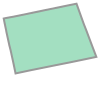

In [ ]:
t_geodata = gpd.read_file('/Users/james/Desktop/Projects/Rent_Prediction/opendata_neighbourhoods/Neighbourhoods.shp')

# rename columns
t_geodata_columns = pd.read_csv('/Users/james/Desktop/Projects/Rent_Prediction/opendata_neighbourhoods/Neighbourhoods_fields.csv')

t_geodata.columns = t_geodata_columns.name.values

# Convert data to lat, long type
t_geodata['geometry'] = t_geodata['geometry'].to_crs({'init': 'EPSG:4269'})
t_geodata['geometry'][1]

In [ ]:
import json
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.models import Label, HoverTool, AjaxDataSource

#Read data to json.
t_geodata_json = json.loads(t_geodata.to_json())

#Convert to String like object.
json_data = json.dumps(t_geodata_json)

#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

hover = HoverTool(tooltips = [('District','@AREA_NAME')])

p = figure(title = 'GTA neighbourhoods', height = 600 , width = 950,tools = [hover])
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


#Add patch renderer to figure.
p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 1)


#Display figure in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

##Find average income for each district in Toronto

In [ ]:
#get Toronto neighbourhood data and extract district codes with their average incomes
t_data = pd.read_csv('/Users/james/Desktop/Projects/Rent_Prediction/opendata_neighbourhoods/neighbourhood-profiles-2016-140-model.csv', )
# Potential Income prospects, ids: 1030, 2273, 2274

t_income = t_data[(t_data.Characteristic == 'Neighbourhood Number') | (t_data.Characteristic == 'Total income: Average amount ($)')]
t_income = t_income.T.reset_index()
t_income.columns = ['area', 'area_code', 'average_income']
t_income = t_income.iloc[6:,:]
print(t_income.head())
print('-' * 60)

#Looks like we need to convert income and area code columns into integers
print(t_income.info())
print('-' * 60)
t_income['average_income'] = t_income['average_income'].apply(lambda a: a.replace(',','')).astype('int64')
t_income['area_code'] = t_income['area_code'].astype('int64')
print(t_income.info())
print('-' * 60)

# Calculate incoem mean
mean_t_income = t_income['average_income'].mean()
print('GTA mean income: ',mean_t_income)

                            area area_code average_income
6                Agincourt North       129         30,414
7   Agincourt South-Malvern West       128         31,825
8                      Alderwood        20         47,709
9                          Annex        95        112,766
10             Banbury-Don Mills        42         67,757
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158 entries, 6 to 163
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   area            158 non-null    object
 1   area_code       158 non-null    object
 2   average_income  158 non-null    object
dtypes: object(3)
memory usage: 3.8+ KB
None
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158 entries, 6 to 163
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------  

In [ ]:
t_geodata.AREA_SHORT_CODE

0      174
1      173
2      172
3      171
4      170
      ... 
153      1
154     24
155     23
156     22
157     21
Name: AREA_SHORT_CODE, Length: 158, dtype: int64

In [ ]:
# Merge districts geodata and Toronto income

all_t_data = t_geodata.merge(t_income, left_on='AREA_SHORT_CODE', right_on='area_code')
#all_t_data
useless_columns_all_t_data = ['_id', 'AREA_ID', 'AREA_ATTR_ID', 'PARENT_AREA_ID', 'AREA_SHORT_CODE', 'AREA_LONG_CODE',
                          'AREA_NAME', 'AREA_DESC']
all_t_data.drop(useless_columns_all_t_data, axis=1, inplace=True)
all_t_data.head()
all_t_data.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/tdata.csv')

In [ ]:
t = pd.read_csv('/Users/james/Desktop/Projects/Rent_Prediction/tgeo.csv', index_col=0)
t.head(25)
t.geometry

0      POLYGON ((-79.3863510515018 43.6978312650188, ...
1      POLYGON ((-79.3974366551459 43.7069299169967, ...
2      POLYGON ((-79.4341131654386 43.660145276359, -...
3      POLYGON ((-79.4387000029275 43.6676608052133, ...
4      POLYGON ((-79.3840399271321 43.6449650943324, ...
                             ...                        
153    POLYGON ((-79.5903711963216 43.7340113037318, ...
154    POLYGON ((-79.5191458651424 43.7739913808407, ...
155    POLYGON ((-79.532251130726 43.735047745472, -7...
156    POLYGON ((-79.5281266038289 43.7442515202697, ...
157    POLYGON ((-79.5339647566358 43.7688567669218, ...
Name: geometry, Length: 158, dtype: object

In [ ]:
t_geodata.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/tgeo.csv')

In [ ]:
from shapely.geometry import Point, Polygon

def find_district(point, df):
    '''
    Returns District name, Area code, and District average income
    '''

    in_shape = []
    for sh in df.geometry:
        within = point.within(sh)
        in_shape.append(within)
    return df.loc[in_shape.index(True), 'area'], df.loc[in_shape.index(True), 'area_code'], df.loc[in_shape.index(True), 'average_income']


houses['mean_district_income'] = 0
houses['district_code'] = 0

not_assigned = []
for row, value in houses.iterrows():
    try:
        result = find_district(Point(houses.loc[row, 'long'], houses.loc[row, 'lat']), all_t_data)
        houses.loc[row, 'city_district'] = result[0]
        houses.loc[row, 'mean_district_income'] = result[2]
        houses.loc[row, 'district_code'] = result[1]
        time.sleep(0.1)
    except:
        not_assigned.append(row)

# Not assigned houses
print(not_assigned)

[24, 67, 76, 131, 202, 232, 233, 440, 460, 479, 556, 580, 594, 767, 811, 830, 849, 908, 915, 992, 999, 1062, 1094, 1144, 1217, 1260, 1266, 1456, 1461, 1462, 1463, 1472, 1487, 1492, 1503, 1757, 1765, 1804, 1990, 2007, 2100, 2132, 2168, 2189, 2273, 2381, 2393, 2422, 2429, 2586, 2664, 2733, 2755, 2764, 2839, 2915, 2920, 2938, 2943, 2975, 2992, 3010, 3021, 3058, 3164, 3221, 3261, 3317, 3328, 3363, 3390, 3397, 3452, 3463, 3486, 3515, 3564, 3572, 3600, 3603, 3604, 3668, 3669, 3773, 3796, 3799, 3954, 3991, 4003, 4091, 4104, 4110, 4135, 4245, 4336, 4437, 4462, 4487, 4617, 4618, 4691, 4705, 4724, 4859, 4867, 4875, 4883, 4905, 4920, 4940, 4946, 5021, 5106, 5314, 5655, 5666, 5754, 5774, 5867, 5870, 5873, 5951, 5961, 5971, 6019, 6042, 6045, 6062, 6076, 6111, 6144, 6150, 6171, 6223, 6353, 6359, 6387, 6400, 6599, 6725, 6757, 6774, 6797, 6803, 6861, 6863, 6884, 6962, 7022, 7086, 7127, 7209, 7229, 7298, 7373, 7401, 7429, 7444, 7456, 7499, 7557, 7741, 7744, 7819, 7820, 7822, 7964, 8010, 8040, 8074, 813

In [ ]:
houses.dropna(subset=['city_district'], inplace=True)
houses['price'] = houses['price'].str.replace(',','')
houses['price'].isnull().values.any()
houses['price'] = houses['price'].astype(float)

In [ ]:
houses.dropna(subset=['city_district'], inplace=True)
houses = houses[(houses['price'] >= 500) & (houses['price'] <= 50000)]
houses.to_csv('/Users/james/Desktop/Projects/Rent_Prediction/houses.csv')

In [ ]:
import seaborn as sns
from scipy import stats

plt.figure(1, figsize=[16,3])

plt.subplots_adjust(hspace=0.4)
sns.distplot(all_t_data['average_income'], fit=stats.norm)
plt.title('Distribution of Income in GTA')
(mu, sigma) = stats.norm.fit(all_t_data['average_income'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(2, figsize=[16,3])

ax1=plt.subplot(1,2,1)
x = all_t_data['average_income']
stats.probplot(x, dist=stats.norm, plot=ax1)
ax1.set_xlabel('')
ax1.set_title('Probplot against normal distribution')


ax2=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
# To transform back
# np.exp(np.log(boxcox_lambda*transformed_array+1)/boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax2)
ax2.set_title('Probplot after Box-Cox transformation')
all_t_data['average_income_transformed'] = transformed_array

plt.figure(3, figsize=[16,3])
sns.distplot(all_t_data['average_income_transformed'], fit=stats.norm)
plt.title('Distribution of Transformed Income in GTA')
(mu, sigma) = stats.norm.fit(all_t_data['average_income_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(4, figsize=[16,3])

sns.distplot(houses['price'], fit=stats.norm)
plt.title('Distribution of Housing Prices in GTA')
(mu, sigma) = stats.norm.fit(houses['price'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(5, figsize=[16,3])

ax3=plt.subplot(1,2,1)
x = houses['price']
stats.probplot(x, dist=stats.norm, plot=ax3)
ax3.set_xlabel('')
ax3.set_title('Probplot against normal distribution')


ax4=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax4)
ax4.set_title('Probplot after Box-Cox transformation')
houses['final_price_transformed'] = transformed_array

plt.figure(6, figsize=[16,3])
sns.distplot(houses['final_price_transformed'], fit=stats.norm)
plt.title('Distribution of Transformed Housing Prices in GTA')
(mu, sigma) = stats.norm.fit(houses['final_price_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')


all_t_data['average_income_log']= np.log(all_t_data['average_income'])
houses['price_log']= np.log(houses['price'])

plt.show()

##Plot Average Income onto Map of Toronto

In [ ]:
missing_districts = []
for district in t_geodata.AREA_NAME:
    if district not in t_data.columns:
        missing_districts.append(district)

print(missing_districts)
print(len(missing_districts))

['North St.James Town', 'Cabbagetown-South St.James Town']
2


In [ ]:
from bokeh.palettes import brewer
from bokeh.models import Label, HoverTool, AjaxDataSource

#Read data to json.
t_geodata_json = json.loads(all_t_data.to_json())

#Convert to String like object.
json_data = json.dumps(t_geodata_json)


#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

#Add hover tool
hover = HoverTool(tooltips = [ ('District','@area'),('Average Income', '@average_income')])


p = figure(title = 'GTA Neighbourhood Income', height = 600 , width = 950, tools = [hover])
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure.
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = all_t_data['average_income_transformed'].min(),
                                 high = all_t_data['average_income_transformed'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 1,
         fill_color = {'field' :'average_income_transformed', 'transform' : color_mapper})


#Display figure in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

In [ ]:
# upload TTC stations and lines
slines_geodata = gpd.read_file('/Users/james/Desktop/Projects/Rent_Prediction/SubwayLine/subwayLines.shp')
sstations_geodata = gpd.read_file('/Users/james/Desktop/Projects/Rent_Prediction/SubwayStation/subwayStations.shp')

slines_geodata['colors'] = ['limegreen', 'plum', 'dodgerblue', 'gold']

for dataset in [slines_geodata, sstations_geodata]:
    dataset['geometry'] = dataset['geometry'].to_crs({'init':"EPSG:4269"})

slines_geodata

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,LINE,SHAPE_Leng,geometry,colors
0,Bloor-Danforth,26377.465093,"LINESTRING (-79.53583 43.63734, -79.53477 43.6...",limegreen
1,Sheppard,5431.438569,"LINESTRING (-79.41094 43.76151, -79.39692 43.7...",plum
2,TransferTunnel,351.921082,"LINESTRING (-79.40527 43.67032, -79.40396 43.6...",dodgerblue
3,Yonge-University-Spadina,30085.504598,"MULTILINESTRING ((-79.37750 43.64819, -79.3776...",gold


##Final House Plot

In [ ]:
from bokeh.models import FixedTicker
from bokeh.models import ColumnDataSource

geosource = GeoJSONDataSource(geojson = all_t_data.to_json())
slines_source = GeoJSONDataSource(geojson = slines_geodata.to_json())
sstation_source = GeoJSONDataSource(geojson = sstations_geodata.to_json())

p = figure(title = 'GTA rental prices projected on average district wages', height = 680 , width = 950,
          active_scroll='wheel_zoom')
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure - Areas and Average Income.
palette_1 = brewer['RdBu'][11] #[::-1]
color_mapper_1 = LinearColorMapper(palette = palette_1,
                                 low = all_t_data['average_income_log'].min(),
                                 high = all_t_data['average_income_log'].max())
p.patches('xs','ys', source = geosource,
              line_color = 'white', line_width = 0.25, fill_alpha = 0.7,
             fill_color = {'field' :'average_income_log', 'transform' : color_mapper_1})

#Add subway lines
p.multi_line('xs', 'ys', source=slines_source, color='colors', line_width=2.5)
#Define custom tick labels for color bar.
tick_labels = {10: '22k', 10.5:'35k', 11:'60k', 11.5:'100k', 12:'162k', 12.5:'268k'}

#Create color bar 1.
color_bar_1 = ColorBar(color_mapper=color_mapper_1, label_standoff=8,width = 500, height = 15,
    border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Specify figure layout.
p.add_layout(color_bar_1, 'below')


# Add houses to the map
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = houses['price_log'].min(),
                                 high = houses['price_log'].max())
geosource_2 = ColumnDataSource(houses)

p1 = p.circle('long', 'lat', alpha=0.3, radius=0.0006, color={'field': 'price_log', 'transform': color_mapper}, source=geosource_2)

#Define custom tick labels for color bar.
original_ticks = [1000, 2000, 5000, 10000, 18000]
log_ticks = np.log(original_ticks)
tick_labels = {log_tick: f'{original_tick / 1000}K' for log_tick, original_tick in zip(log_ticks, original_ticks)}
ticker = FixedTicker(ticks=log_ticks)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 15,
                     border_line_color=None,location = (0,0), orientation = 'horizontal',
                     major_label_overrides = tick_labels, ticker=ticker)

#Add hover tool
hover = HoverTool(renderers=[p1],
                     tooltips =[('District','@city_district'),
                               ('District Income', '$ @mean_district_income{0,0}'),
                               ('Price','$ @price{0,0}'),
                               ('Type', '@type'),
                               ('MLS','@mls')])
p.add_tools(hover)

#Specify figure layout.
p.add_layout(color_bar, 'below')

# Add subway stations
p.circle('x', 'y', source=sstation_source, radius=0.001, color="white", line_color='black', line_width=0.3)

#Display figure in Jupyter Notebook.
output_notebook()

#Display figure.
show(p)

Loading BokehJS ...

##Further Analysis

In [ ]:
houses_edited = houses.copy()
houses_1bed = houses_edited[houses_edited['bedrooms'] == 1]
houses_2bed = houses_edited[houses_edited['bedrooms'] == 2]
houses_3bed = houses_edited[houses_edited['bedrooms'] == 3]
print('Average monthly rental price in Toronto per bedroom:')
print('-' * 60)
print('1 Bedroom:', houses_1bed['price'].mean())
print('2 Bedrooms:', houses_2bed['price'].mean())
print('3 Bedrooms:', houses_3bed['price'].mean())

Average monthly rental price in Toronto per bedroom:
------------------------------------------------------------
1 Bedroom: 2504.170079260238
2 Bedrooms: 3263.3083881578946
3 Bedrooms: 3957.546571136131


In [ ]:
houses_edited.type.unique()

array(['Condo Apt', 'Comm Element Condo', 'Condo Townhouse',
       'Co-Ownership Apt', 'Triplex', 'Detached', 'Co-Op Apt',
       'Att/Row/Twnhouse', 'Other', 'Upper Level', 'Store W/Apt/Offc',
       'Store W/Apt/Office', 'Semi-Detached', 'Lower Level', 'Det Condo',
       'Semi-Det Condo', 'Room', 'Leasehold Condo', 'Phased Condo'],
      dtype=object)

In [ ]:
houses_edited.sqft.unique()

array(['0-499 sqft', '900–999 sqft', '600–699 sqft', '500–599 sqft',
       '1600–1799 sqft', '700–799 sqft', '800–899 sqft', '1000–1199 sqft',
       '1200–1399 sqft', 'N/A sqft', '1500–2000 sqft', '1100–1500 sqft',
       '1400–1599 sqft', '1800–1999 sqft', '700–1100 sqft',
       '2000–2249 sqft', '2250–2499 sqft', '700 sqft', '2500–2749 sqft',
       '3250–3499 sqft', '2750–2999 sqft', '900–1099 sqft',
       '3750–3999 sqft', '500–699 sqft', '3000–3249 sqft', '700–899 sqft'],
      dtype=object)

In [ ]:
# replace 'N/A sqft' with NaN
houses_edited['sqft'] = houses_edited['sqft'].replace('N/A sqft', np.nan)

# remove rows with NaN values
houses_edited = houses_edited.dropna(subset=['sqft'])

# remove the ' sqft' from each entry
houses_edited['sqft'] = houses_edited['sqft'].str.replace(' sqft', '')
houses_edited['sqft'] = houses_edited['sqft'].astype(str)
houses_edited

,full_address,type,price,bedrooms,bathrooms,sqft,parking,mls,full_link,lat,long,city_district,mean_district_income,district_code,final_price_transformed,price_log
1,"2106 - 3 Gloucester St, Ontario, Canada",Condo Apt,2350.0,1,1,0-499,0,C5937412,https://www.zoocasa.com//toronto-on-real-estat...,43.666445,-79.384484,Church-Wellesley,53583,167,1.136886,7.762171
2,"1708 - 88 Blue Jays Way, Ontario, Canada",Condo Apt,4200.0,2,2,900–999,1,C5932668,https://www.zoocasa.com//toronto-on-real-estat...,43.645505,-79.392457,Wellington Place,70600,164,1.137383,8.342840
3,"918 - 100 Harrison Gdn Blvd N, Ontario, Canada",Condo Apt,2550.0,1,1,600–699,1,C5933576,https://www.zoocasa.com//toronto-on-real-estat...,43.757227,-79.404128,Avondale,45326,153,1.136972,7.843849
4,"1911 - 45 Charles St E, Ontario, Canada",Condo Apt,2500.0,1,2,600–699,0,C5932944,https://www.zoocasa.com//toronto-on-real-estat...,43.668911,-79.383977,Church-Wellesley,53583,167,1.136952,7.824046
5,"1412 - 33 Helendale Ave, Ontario, Canada",Condo Apt,2600.0,2,2,600–699,1,C5932184,https://www.zoocasa.com//toronto-on-real-estat...,43.708860,-79.399581,Yonge-Eglinton,89330,100,1.136992,7.863267
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27990,"828 - 251 Manitoba St, Ontario, Canada",Condo Apt,2300.0,1,1,0-499,1,W5740084,https://www.zoocasa.com//toronto-on-real-estat...,43.623631,-79.489415,Mimico-Queensway,54438,160,1.136863,7.740664
27991,"4109 - 9 Bogert Ave E, Ontario, Canada",Condo Apt,3200.0,1,2,600–699,1,C5738335,https://www.zoocasa.com//toronto-on-real-estat...,43.760382,-79.411336,Lansing-Westgate,72371,38,1.137182,8.070906
27992,"4502 - 50 Charles St E, Ontario, Canada",Condo Apt,2400.0,0,1,0-499,0,C5740096,https://www.zoocasa.com//toronto-on-real-estat...,43.669439,-79.382999,Church-Wellesley,53583,167,1.136909,7.783224
27993,"3102 - 180 University Ave, Ontario, Canada",Condo Apt,4400.0,1,1,800–899,1,C5739989,https://www.zoocasa.com//toronto-on-real-estat...,43.648827,-79.386259,Yonge-Bay Corridor,56526,170,1.137413,8.389360


In [ ]:
# function to process each row
def process_row(row):
    row = row.strip()  # Remove any leading or trailing spaces
    if '–' in row:  # Notice the change here: '–' instead of '-'
        min_sqft, max_sqft = map(int, row.split('–'))  # And here
        return (min_sqft + max_sqft) / 2
    if '-' in row:  # Notice the change here: '–' instead of '-'
        min_sqft, max_sqft = map(int, row.split('-'))  # And here
        return (min_sqft + max_sqft) / 2
    else:
        try:
            return int(row)
        except ValueError as e:
            print(f'Failed to parse "{row}"')
            raise e  # re

# apply the function to each row
houses_edited['sqft_avg'] = houses_edited['sqft'].apply(process_row)
houses_edited['sqft_avg']

1        249.5
2        949.5
3        649.5
4        649.5
5        649.5
         ...  
27990    249.5
27991    649.5
27992    249.5
27993    849.5
27994    549.5
Name: sqft_avg, Length: 21259, dtype: float64

In [ ]:
houses_edited.type.replace({
    'Triplex': 'Plex',
    'Det Condo': 'Condo Apt',
    'Leasehold Condo': 'Condo Apt'
}, inplace = True)
houses_edited.to_csv('houses_edited.csv')
houses_edited.head(2)

,full_address,type,price,bedrooms,bathrooms,sqft,parking,mls,full_link,lat,long,city_district,mean_district_income,district_code,final_price_transformed,price_log,sqft_avg
1,"2106 - 3 Gloucester St, Ontario, Canada",Condo Apt,2350.0,1,1,0-499,0,C5937412,https://www.zoocasa.com//toronto-on-real-estat...,43.666445,-79.384484,Church-Wellesley,53583,167,1.136886,7.762171,249.5
2,"1708 - 88 Blue Jays Way, Ontario, Canada",Condo Apt,4200.0,2,2,900–999,1,C5932668,https://www.zoocasa.com//toronto-on-real-estat...,43.645505,-79.392457,Wellington Place,70600,164,1.137383,8.342840,949.5


In [ ]:
houses_edited = pd.read_csv('houses_edited.csv')
needed_columns = ['sqft_avg','parking','mean_district_income','bedrooms','bathrooms','type','price']
house_dummies = pd.get_dummies(houses_edited[needed_columns])
predictors = house_dummies.drop('price',axis=1).columns
house_dummies.head()

,sqft_avg,parking,mean_district_income,bedrooms,bathrooms,price,type_Att/Row/Twnhouse,type_Co-Op Apt,type_Co-Ownership Apt,type_Comm Element Condo,type_Condo Apt,type_Condo Townhouse,type_Detached,type_Lower Level,type_Other,type_Phased Condo,type_Room,type_Semi-Det Condo,type_Store W/Apt/Offc,type_Upper Level
0,249.5,0,53583,1,1,2350.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
1,949.5,1,70600,2,2,4200.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
2,649.5,1,45326,1,1,2550.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,649.5,0,53583,1,2,2500.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,649.5,1,89330,2,2,2600.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [ ]:
!pip install pandas_profiling --quiet
!pip install ipywidgets --quiet


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip


In [ ]:
import pandas_profiling
import ipywidgets
houses_edited.profile_report()

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/numba/core/decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/visions/backends/shared/nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:
/var/folders/jh/8q7m764s08d_ysjxprt1p0p80000gn/T/ipykernel_5038/1637482529.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

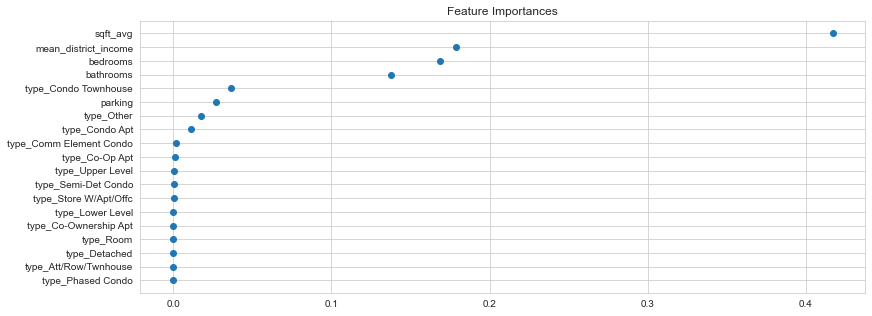

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

sns.set_style("whitegrid")
plt.figure(figsize=[13,5])
df = house_dummies.dropna(subset=['sqft_avg'])
model = ExtraTreesRegressor(n_estimators=10)
model.fit(df[predictors], df.price)
# display the relative importance of each attribute

sorted_feature_importance = sorted(zip(model.feature_importances_, df[predictors].columns))

x = [a[0] for a in sorted_feature_importance]
y = [a[1] for a in sorted_feature_importance]

plt.scatter(x,y)
plt.title('Feature Importances')
plt.show()

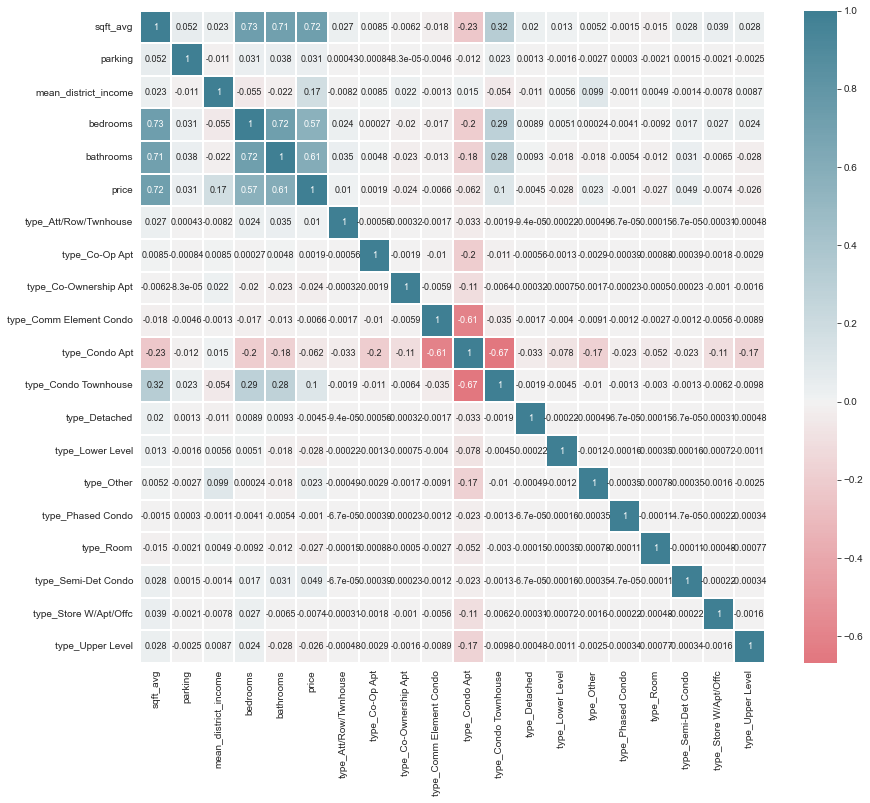

In [ ]:
# Create features Heatmap to see how feature are correlated with final_price

def correlantion_heatmap(df, center = None):
    fig, ax = plt.subplots(figsize = [14,12])
    colormap = sns.diverging_palette(10, 220, as_cmap=True)
    fig = sns.heatmap(df.corr(),
                cmap = colormap,
               center = center,
                annot = True,
                linewidths = 0.1,
                annot_kws={'fontsize':9})


correlantion_heatmap(house_dummies, center=0)

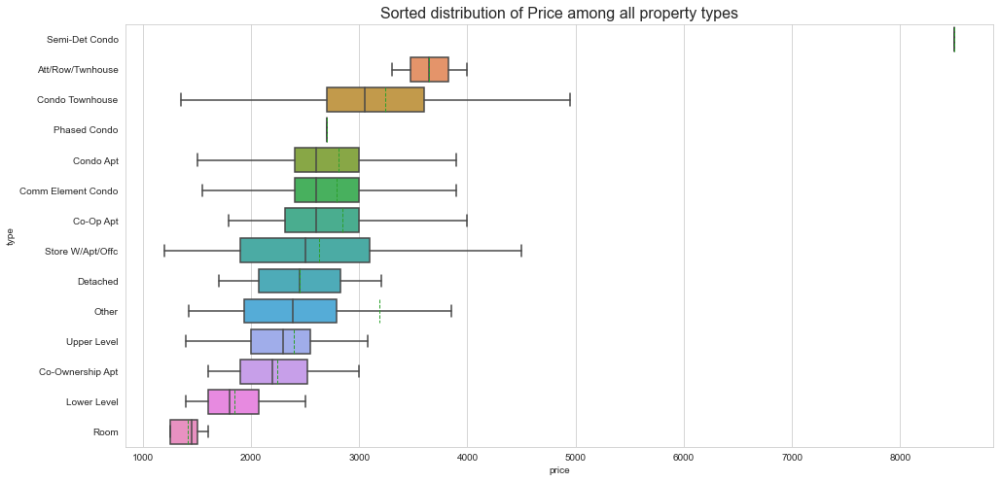

In [ ]:
sns.set_style("whitegrid")
houses_types = pd.unique(houses_edited.type)
plt.subplots(figsize=[16,8])
sorted_medians = sorted([(houses_edited[houses_edited.type==st].price.median(), st) for st in houses_types], reverse=True)
sns.boxplot(y = 'type', x = 'price', data = houses_edited, orient='h', showfliers=False, meanline =True, showmeans=True,
            order=[b for a,b in sorted_medians])
plt.title('Sorted distribution of Price among all property types', fontsize=16)
plt.show()

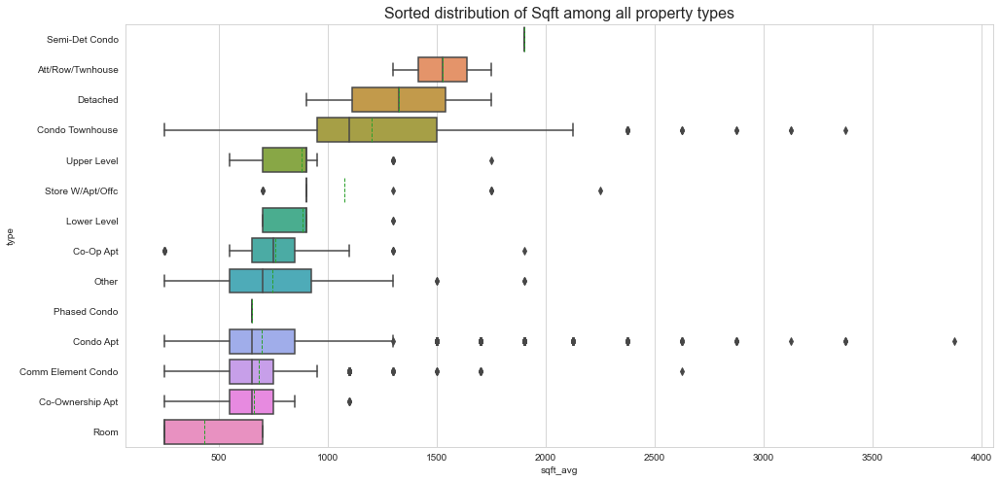

In [ ]:
plt.subplots(figsize=[16,8])
sorted_medians = sorted([(houses_edited[houses_edited.type==st].sqft_avg.median(), st) for st in houses_types], reverse=True)
sns.boxplot(y = 'type', x = 'sqft_avg', data = houses_edited, orient='h', showfliers=True, meanline =True, showmeans=True,
           order=[b for a,b in sorted_medians])
plt.title('Sorted distribution of Sqft among all property types', fontsize=16)
plt.show()

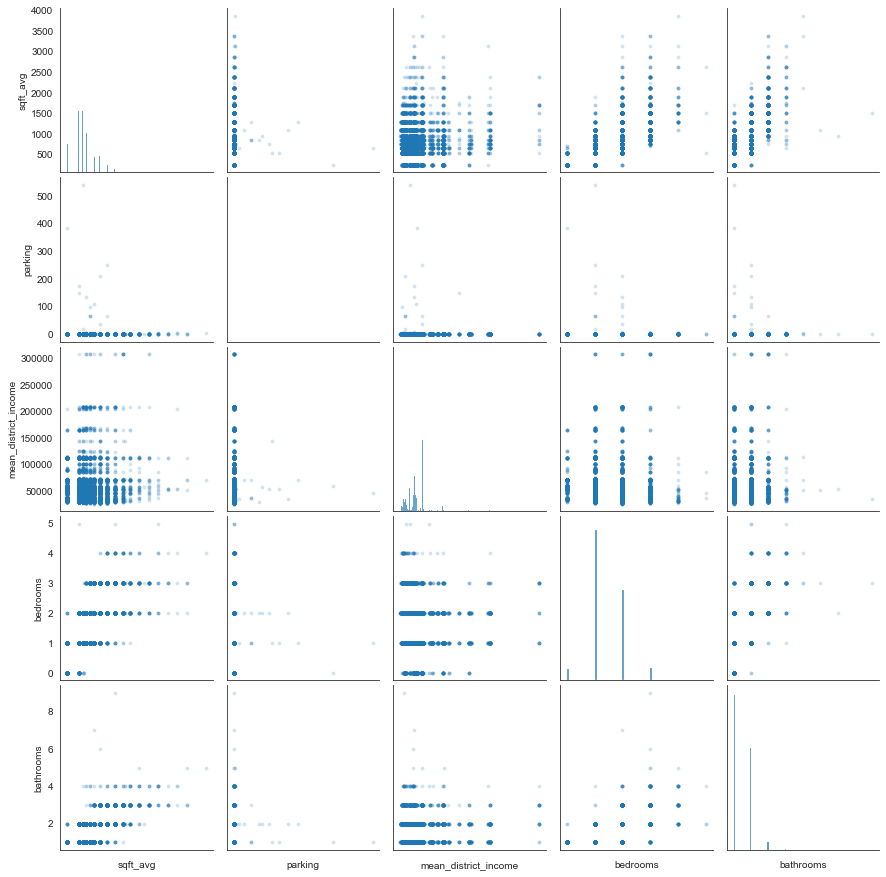

In [ ]:
# Plot pairwise relationships
sns.set_style("white")
pp = sns.pairplot(house_dummies[pd.notna(house_dummies.sqft_avg)][predictors[:5]], diag_kind = 'hist', plot_kws=dict(s=14, alpha=.2, linewidth=0))
pp.set(xticklabels=[])
plt.show()

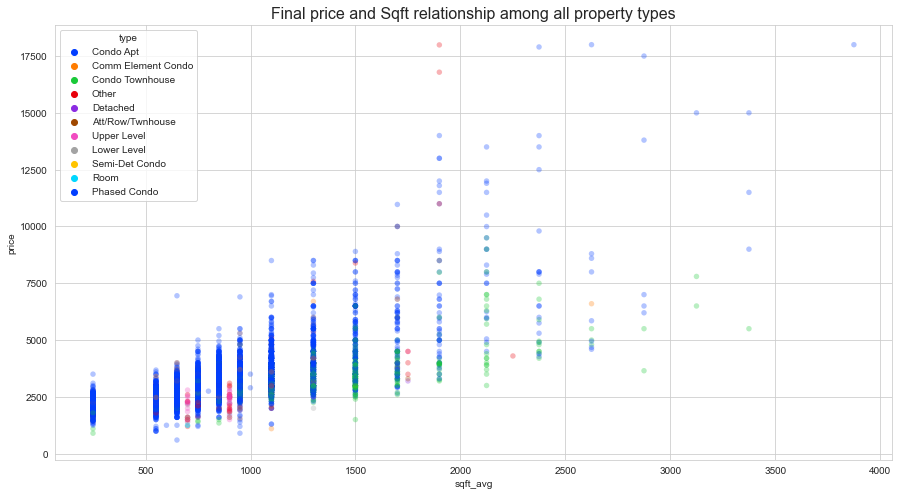

In [ ]:
# Check how final_price and sqft are related to each other among all property types
sns.set_style("whitegrid")
plt.figure(figsize=[15,8])
sns.scatterplot(x='sqft_avg', y='price' ,data=houses_edited,
                hue = houses_edited.type.replace({
                    'Plex': 'Other',
                    'Link': 'Other',
                    'Co-Ownership Apt': 'Other',
                    'Co-Op Apt': 'Other',
                    'Store W/Apt/Offc': 'Other'}),
                    linewidth=0, alpha=0.3, palette='bright', s=30)
plt.title('Final price and Sqft relationship among all property types', fontsize=16)
plt.show()

In [ ]:
pip install fancyimpute --quiet


[notice] A new release of pip available: 22.3.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin
from fancyimpute import KNN, IterativeImputer
from sklearn.ensemble import RandomForestRegressor

class Impute_sqft(BaseEstimator, TransformerMixin):
    def __init__(self, how='random forest'):
        self.how = how

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        import sys
        sys.setrecursionlimit(100000) #Increase the recursion limit of the OS
        result = X.copy()

        if self.how == 'random forest':
            train_X = house_dummies.dropna(subset=['sqft_avg']).drop(columns=['sqft_avg'])
            train_Y = house_dummies.dropna(subset=['sqft_avg'])['sqft_avg']
            test_X = house_dummies[pd.isna(house_dummies.sqft_avg)].drop(columns=['sqft_avg'])

            rf = RandomForestRegressor()
            rf.fit(train_X, train_Y)
            pred_Y = rf.predict(test_X)
            result.loc[test_X.index,'sqft_avg'] = pred_Y

        if self.how == 'knn':
            knn_imputer = KNN(k=30)
            result_imputed = knn_imputer.fit_transform(house_dummies)
            result = pd.DataFrame(result_imputed, columns=house_dummies.columns, index=house_dummies.index)
            result = result.loc[X.index,:]

        if self.how == 'mice':
            mice_imputer = IterativeImputer(estimator=RandomForestRegressor(), missing_values=np.nan)
            result_imputed = mice_imputer.fit_transform(house_dummies)
            result = pd.DataFrame(result_imputed, columns=house_dummies.columns, index=house_dummies.index)
            result = result.loc[X.index,:]

        if self.how in ['mean', 'median', 'mode']:
            if self.how == 'mean':
                strategy = 'mean'
            elif self.how == 'median':
                strategy = 'median'
            else: # mode
                strategy = lambda x: pd.Series.mode(x)[0]
            result['sqft_avg'] = result.groupby('type')['sqft_avg'].transform(lambda x: x.fillna(x.agg(strategy)))

        return result[predictors]

imputer = Impute_sqft(how='mice')
houses_nona = imputer.fit_transform(house_dummies[predictors])


In [ ]:
numeric_feats = ['sqft_avg', 'mean_district_income', 'price']
skewness = pd.DataFrame({
    'Skew': house_dummies[numeric_feats].apply(lambda x: stats.skew(x.dropna())).sort_values(ascending=False)})

skewness = skewness[abs(skewness.Skew) > 0.75]
skewness

,Skew
price,5.624409
mean_district_income,3.549776
sqft_avg,1.650750


In [ ]:
from sklearn.preprocessing import PowerTransformer
from sklearn.metrics import mean_squared_error, mean_absolute_error

houses_nona_copy = houses_nona.copy()
houses_nona_copy['mean_district_income'] = houses_nona.mean_district_income/10
houses_nona_copy['price'] = house_dummies.price/100

yeo_johnson_lambdas = []

pt = PowerTransformer(method='yeo-johnson')
for numeric_feat in numeric_feats:
    houses_nona_copy[numeric_feat] = pt.fit_transform(houses_nona_copy[[numeric_feat]])
    yeo_johnson_lambdas.append(pt.lambdas_[0])

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(houses_nona_copy[predictors], houses_nona_copy.price, train_size=0.7,
                                                    stratify=houses_nona_copy['type_Condo Apt'].values)

In [ ]:
from sklearn.utils import all_estimators
from sklearn.base import RegressorMixin

estimators = all_estimators(type_filter='regressor')

for name, class_ in estimators:
    if issubclass(class_, RegressorMixin):
        print(name)

ARDRegression
AdaBoostRegressor
BaggingRegressor
BayesianRidge
CCA
DecisionTreeRegressor
DummyRegressor
ElasticNet
ElasticNetCV
ExtraTreeRegressor
ExtraTreesRegressor
GammaRegressor
GaussianProcessRegressor
GradientBoostingRegressor
HistGradientBoostingRegressor
HuberRegressor
IsotonicRegression
KNeighborsRegressor
KernelRidge
Lars
LarsCV
Lasso
LassoCV
LassoLars
LassoLarsCV
LassoLarsIC
LinearRegression
LinearSVR
MLPRegressor
MultiOutputRegressor
MultiTaskElasticNet
MultiTaskElasticNetCV
MultiTaskLasso
MultiTaskLassoCV
NuSVR
OrthogonalMatchingPursuit
OrthogonalMatchingPursuitCV
PLSCanonical
PLSRegression
PassiveAggressiveRegressor
PoissonRegressor
QuantileRegressor
RANSACRegressor
RadiusNeighborsRegressor
RandomForestRegressor
RegressorChain
Ridge
RidgeCV
SGDRegressor
SVR
StackingRegressor
TheilSenRegressor
TransformedTargetRegressor
TweedieRegressor
VotingRegressor


In [ ]:
from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV, ElasticNetCV, ARDRegression, BayesianRidge, HuberRegressor, LarsCV, OrthogonalMatchingPursuitCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import NuSVR, SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import ShuffleSplit, cross_validate, GridSearchCV, KFold
from sklearn.isotonic import  IsotonicRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import make_scorer
import lightgbm as lgbm
import xgboost as xgb

In [ ]:
def custom_mae_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return mean_absolute_error(y, y_pred)

custom_mae = make_scorer(custom_mae_, greater_is_better=False)

def custom_mape_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return np.mean(np.abs((y - y_pred) / y)) * 100

custom_mape = make_scorer(custom_mape_, greater_is_better=False)


def custom_rmse_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return np.sqrt(mean_squared_error(y, y_pred))

custom_rmse = make_scorer(custom_rmse_, greater_is_better=False)

In [ ]:
#Machine Learning Algorithm (MLA) Selection and Initialization
MLA = [
#     #Ensemble Methods
    AdaBoostRegressor(),
    BaggingRegressor(),
    ExtraTreesRegressor(),
    GradientBoostingRegressor(),
    RandomForestRegressor(),
    lgbm.LGBMRegressor(),
    xgb.XGBRegressor(objective='reg:squarederror'),


#     #Kernel ridge regression
#     KernelRidge(),

#     #GLM
    LinearRegression(),
    make_pipeline(RobustScaler(), LassoCV()),
    make_pipeline(RobustScaler(), ElasticNetCV()),
    RidgeCV(),
    LarsCV(),
    BayesianRidge(),
    HuberRegressor(),
    OrthogonalMatchingPursuitCV(),

#    #Decomposition
    PLSRegression(),

#     #KNN
    KNeighborsRegressor(),

    #SVM
    NuSVR(),
    SVR(),

#     #Tree Models
    DecisionTreeRegressor()
    ]


#split dataset in cross-validation with this splitter class: http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.ShuffleSplit.html#sklearn.model_selection.ShuffleSplit
#note: this is an alternative to train_test_split
cv_split = KFold(n_splits=4, shuffle=True, random_state=10) # run model 10x with 60/30 split intentionally leaving out 10%

#create table to compare MLA metrics
MLA_columns = ['MLA Name', 'MLA Parameters','MLA Train Accuracy Mean', 'MLA Test Accuracy Mean', 'MLA Test Accuracy 3*STD' ,'MLA Time']
MLA_compare = pd.DataFrame(columns = MLA_columns)

#index through MLA and save performance to table
row_index = 0
for alg in MLA:

    #set name and parameters
    MLA_name = alg.__class__.__name__
    print(MLA_name + '_'*10, end="\r")
    MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
    MLA_compare.loc[row_index, 'MLA Parameters'] = str(alg.get_params())

    #score model with cross validation: http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_validate.html#sklearn.model_selection.cross_validate
    cv_results = cross_validate(alg, X_train, y_train, cv  = cv_split,
                               return_train_score=True, scoring=custom_mae)

    MLA_compare.loc[row_index, 'MLA Time'] = cv_results['fit_time'].mean()
    MLA_compare.loc[row_index, 'MLA Train Accuracy Mean'] = -cv_results['train_score'].mean()
    MLA_compare.loc[row_index, 'MLA Test Accuracy Mean'] = -cv_results['test_score'].mean()
    #if this is a non-bias random sample, then +/-3 standard deviations (std) from the mean, should statistically capture 99.7% of the subsets
    MLA_compare.loc[row_index, 'MLA Test Accuracy 3*STD'] = cv_results['test_score'].std()*3   #let's know the worst that can happen!

    row_index+=1


MLA_compare.sort_values('MLA Test Accuracy Mean', inplace = True, ascending = True)
MLA_compare

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/linear_model/_huber.py:342: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/linear_model/_huber.py:342: ConvergenceWarn

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not have valid feature names, but PowerTransformer was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:420: UserWarning: X does not

,MLA Name,MLA Parameters,MLA Train Accuracy Mean,MLA Test Accuracy Mean,MLA Test Accuracy 3*STD,MLA Time
6,XGBRegressor,"{'objective': 'reg:squarederror', 'base_score'...",153.511833,183.505145,15.805832,1.059205
5,LGBMRegressor,"{'boosting_type': 'gbdt', 'class_weight': None...",177.667285,188.223035,17.809611,0.147675
4,RandomForestRegressor,"{'bootstrap': True, 'ccp_alpha': 0.0, 'criteri...",145.868392,192.590368,16.779153,1.293177
1,BaggingRegressor,"{'base_estimator': 'deprecated', 'bootstrap': ...",147.068929,194.131136,18.133962,0.172118
2,ExtraTreesRegressor,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",126.275091,197.331166,19.119158,1.824876
3,GradientBoostingRegressor,"{'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': ...",196.766868,200.965035,20.332452,0.593657
19,DecisionTreeRegressor,"{'ccp_alpha': 0.0, 'criterion': 'squared_error...",126.275091,203.232533,19.127725,0.020194
16,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric...",188.914672,212.198127,18.844331,0.005317
18,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",221.982533,224.596628,24.920741,7.553284
17,NuSVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",222.540839,224.976338,24.512915,7.170872


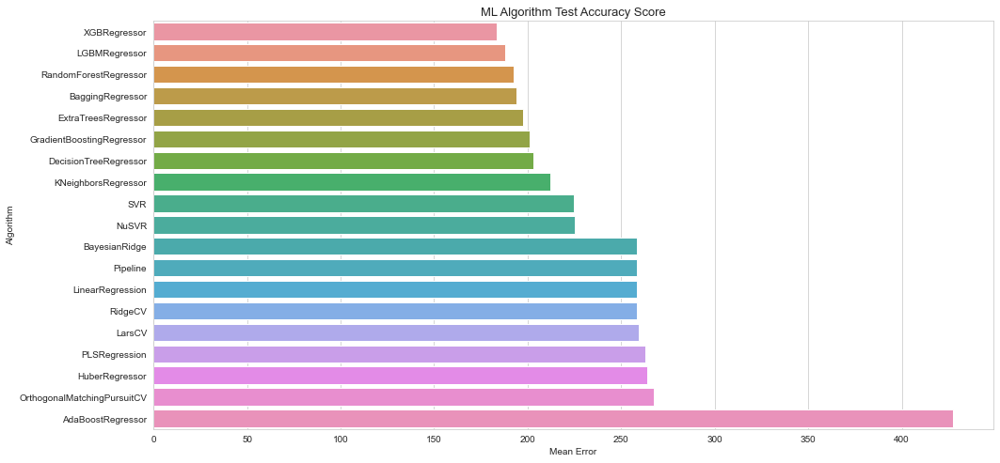

In [ ]:
fig, ax = plt.subplots(figsize = [16,8])

sns.barplot(x = 'MLA Test Accuracy Mean', y = 'MLA Name', data = MLA_compare,)
plt.title('ML Algorithm Test Accuracy Score', fontsize=13)
plt.xlabel('Mean Error')
plt.ylabel('Algorithm')
plt.show()